


# Aleph2Image (Delta)


> "I was afraid that not a
single thing on earth would ever again surprise me"

-Jorge Luis Borges



---




#### What is this?

This is a notebook that uses DALL-E's decoder and CLIP to generate images from text. I will very likely make this better & easier to use in the future.

Feel free to send correspondence to [@advadnoun](https://twitter.com/advadnoun) on Twitter. If you use this notebook or modify it, please be cool and link back to my twitter. 

If you're feeling generous while your Waluigi (or whatever you choose) loads, you can donate to @rynnn on Venmo :)



---



#### Thanks!

Many thanks to OpenAI for releasing their models CLIP and DALL-E (the encoder and decoder parts, specifically). I am not affiliated with them.


https://github.com/openai/DALL-E/ (Aditya Ramesh, Mikhail Pavlov, Gabriel Goh, Scott Gray, Chelsea Voss, Alec Radford, Mark Chen, Ilya Sutskever)

https://github.com/openai/CLIP (Alec Radford, \* Jong Wook Kim,\* Chris Hallacy, Aditya Ramesh, Gabriel Goh, Sandhini Agarwal,
Girish Sastry, Amanda Askell, Pamela Mishkin, Jack Clark, Gretchen Krueger, Ilya Sutskever)

\* equal contribution

Also, as a good launching point for future directions and to find more related work, see https://distill.pub/2017/feature-visualization/ by Chris Olah, Alexander Mordvintsev, Ludwig Schubert.



---



# How do I use this?

First, type in your description where it says *Insert text here*.


Second, click the 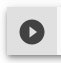 
button that shows up next to the text under the heading **This one!**. The button appears when you move your mouse over the text **This one!** Wait for a bit as it loads and goes in circles, and then move on to the third step when it finishes running.

Third, click on the upper bar at the top of the page where it says **Runtime**, and then click **Restart and run all**. 

Your output will appear at the bottom of this page as it trains after a little while. Scroll down below everything else to see new images appear. The images will start by looking like dirt, but the page will eventually ding and show new images as it begins to attempt to match the image to your description. 

# Choose Text

In [1]:
text_input = '''a tree at sunset'''

# This one!

In [2]:
import subprocess

CUDA_version = [s for s in subprocess.check_output(["nvcc", "--version"]).decode("UTF-8").split(", ") if s.startswith("release")][0].split(" ")[-1]
print("CUDA version:", CUDA_version)

if CUDA_version == "10.0":
    torch_version_suffix = "+cu100"
elif CUDA_version == "10.1":
    torch_version_suffix = "+cu101"
elif CUDA_version == "10.2":
    torch_version_suffix = ""
else:
    torch_version_suffix = "+cu110"

!pip install torch==1.7.1{torch_version_suffix} torchvision==0.8.2{torch_version_suffix} -f https://download.pytorch.org/whl/torch_stable.html ftfy regex

CUDA version: 11.0
Looking in links: https://download.pytorch.org/whl/torch_stable.html
     |█████████████████████████████▉  | 1078.0 MB 85.9 MB/s eta 0:00:011   |███████▊                        | 280.2 MB 78.9 MB/s eta 0:00:12     |██████████████████▉             | 682.7 MB 84.0 MB/s eta 0:00:06     |███████████████████▋            | 709.5 MB 92.8 MB/s eta 0:00:05

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



     |████████████████████████████████| 1156.8 MB 104.1 MB/s eta 0:00:01

     |████████████████████████████████| 1156.8 MB 9.3 kB/s 
     |████████████████████████████████| 12.9 MB 1.8 MB/s eta 0:00:01
     |████████████████████████████████| 66 kB 902 kB/s eta 0:00:011
     |████████████████████████████████| 733 kB 3.1 MB/s eta 0:00:01
  Created wheel for ftfy: filename=ftfy-5.9-py3-none-any.whl size=46451 sha256=830ea8342ed2e6ec243e7386601b9552966005f1106dfe571bdd9c9ac6fdca15
  Stored in directory: /root/.cache/pip/wheels/5c/d4/80/13a4398421dd85abb4320a7d735004241c586525783d002075
Successfully built ftfy
  Attempting uninstall: torch
    Found existing installation: torch 1.7.1
    Uninstalling torch-1.7.1:
      Successfully uninstalled torch-1.7.1
  Attempting uninstall: torchvision
    Found existing installation: torchvision 0.8.2
    Uninstalling torchvision-0.8.2:
      Successfully uninstalled torchvision-0.8.2


# Top


In [47]:
from IPython import display

In [55]:
!pip install -q Js2Py
from js2py import eval_js

In [56]:
# # don't use half of these lol

# import torch
# import numpy as np
# import torchvision
# import torchvision.transforms.functional as TF

# import PIL
# import matplotlib.pyplot as plt

# import os
# import random
# import imageio
# from IPython import display
# from IPython.core.interactiveshell import InteractiveShell
# InteractiveShell.ast_node_interactivity = "all"

# import glob

# from google.colab import output



In [3]:
# were you lucky today?

!nvidia-smi -L


GPU 0: GeForce RTX 2080 Ti (UUID: GPU-52ef806b-7ece-1003-f6f1-51e181fd1dce)


In [12]:
!apt-get -qq update && apt-get -qq -y install git

# Perceptor

In [29]:
!pip install -q clip ftfy

In [37]:
!pip install --trusted-host pypi.org imageio

     |████████████████████████████████| 3.3 MB 2.1 MB/s eta 0:00:01


In [38]:
!mkdir -p /content
%cd /content
!git clone https://github.com/openai/CLIP.git
%cd /content/CLIP/

/content
fatal: destination path 'CLIP' already exists and is not an empty directory.
/content/CLIP


In [40]:
import os
import clip
import torch

clip.available_models()

import numpy as np

# Load the model
perceptor, preprocess = clip.load('ViT-B/32', jit=True)
perceptor = perceptor.eval()

# Params

In [48]:
# probably don't mess with this unless you're changing generator size
im_shape = [512, 512, 3]
sideX, sideY, channels = im_shape
batch_size = 1

# Define

In [49]:
def displ(img, pre_scaled=True):
  img = np.array(img)[:,:,:]
  img = np.transpose(img, (1, 2, 0))
  if not pre_scaled:
    img = scale(img, 48*4, 32*4)
  imageio.imwrite(str(3) + '.png', np.array(img))
  return display.Image(str(3)+'.png')

def gallery(array, ncols=2):
    nindex, height, width, intensity = array.shape
    nrows = nindex//ncols
    assert nindex == nrows*ncols
    # want result.shape = (height*nrows, width*ncols, intensity)
    result = (array.reshape(nrows, ncols, height, width, intensity)
              .swapaxes(1,2)
              .reshape(height*nrows, width*ncols, intensity))
    return result

def card_padded(im, to_pad=3):
  return np.pad(np.pad(np.pad(im, [[1,1], [1,1], [0,0]],constant_values=0), [[2,2], [2,2], [0,0]],constant_values=1),
            [[to_pad,to_pad], [to_pad,to_pad], [0,0]],constant_values=0)

def get_all(img):
  img = np.transpose(img, (0,2,3,1))
  cards = np.zeros((img.shape[0], sideX+12, sideY+12, 3))
  for i in range(len(img)):
    cards[i] = card_padded(img[i])
  print(img.shape)
  cards = gallery(cards)
  imageio.imwrite(str(3) + '.png', np.array(cards))
  return display.Image(str(3)+'.png')
  

# Generator

In [50]:
!pip install -Uq git+https://github.com/openai/DALL-E.git

In [51]:
import io
import os, sys
import requests
import PIL

import torch
import torchvision.transforms as T
import torchvision.transforms.functional as TF


from dall_e import map_pixels, unmap_pixels, load_model
target_image_size = sideX

def preprocess(img):
    s = min(img.size)
    
    if s < target_image_size:
        raise ValueError(f'min dim for image {s} < {target_image_size}')
        
    r = target_image_size / s
    s = (round(r * img.size[1]), round(r * img.size[0]))
    img = TF.resize(img, s, interpolation=PIL.Image.LANCZOS)
    img = TF.center_crop(img, output_size=2 * [target_image_size])
    img = torch.unsqueeze(T.ToTensor()(img), 0)
    return map_pixels(img)


model = load_model("https://cdn.openai.com/dall-e/decoder.pkl", 'cuda')
encoder = load_model("https://cdn.openai.com/dall-e/encoder.pkl", 'cuda')


In [52]:
oi = encoder(map_pixels(.2*torch.nn.functional.interpolate(torch.rand(1, 3, sideX//4, sideY//4), (sideX, sideY))).cuda())

# Latent coordinates

In [53]:
import torchvision
import imageio
import random


class Pars(torch.nn.Module):
    def __init__(self):
        super(Pars, self).__init__()


        hots = torch.nn.functional.one_hot((torch.arange(0, 8192).to(torch.int64)), num_classes=8192)
        rng = torch.zeros(batch_size, 64*64, 8192).uniform_()**torch.zeros(batch_size, 64*64, 8192).uniform_(.1,1)
        for b in range(batch_size):
          for i in range(64**2):
            rng[b,i] = hots[[np.random.randint(8191)]]

        rng = rng.permute(0, 2, 1)

        self.normu = torch.nn.Parameter(rng.cuda().view(batch_size, 8192, 64, 64))

        # ended up not doing static, as the brown seems to actually work better here

        # self.normu = torch.nn.Parameter(oi.cuda().clone())



    def forward(self):

      
      normu = torch.softmax(hadies*self.normu.reshape(batch_size, 8192//2, -1), dim=1).view(batch_size, 8192, 64, 64)
      return normu


lats = Pars().cuda()
mapper = [lats.normu]
optimizer = torch.optim.Adam([{'params': mapper, 'lr': .05}])
eps = 0



tx = clip.tokenize(text_input)
t = perceptor.encode_text(tx.cuda()).detach().clone()


nom = torchvision.transforms.Normalize((0.48145466, 0.4578275, 0.40821073), (0.26862954, 0.26130258, 0.27577711))


will_it = False
hadies = 1.
with torch.no_grad():
  al = unmap_pixels(torch.sigmoid(model(lats()).cpu().float())).numpy()
  for allls in al:
    displ(allls[:3])
    print('\n')
  # print(lats())
  # print(lats().sum())

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


# Train


  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-1.9639], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 0


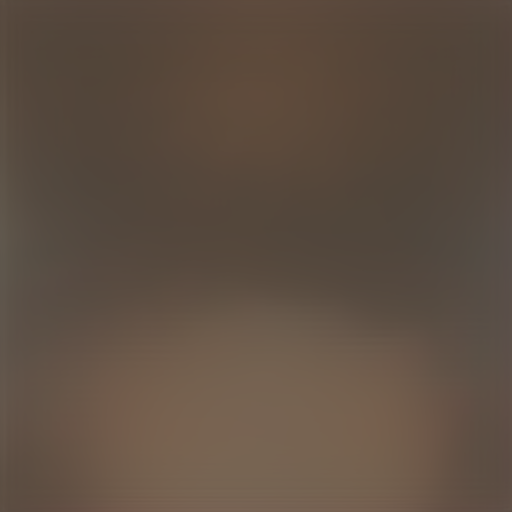




  ##########################################################
   [0, tensor([-3.2969], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 50


Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


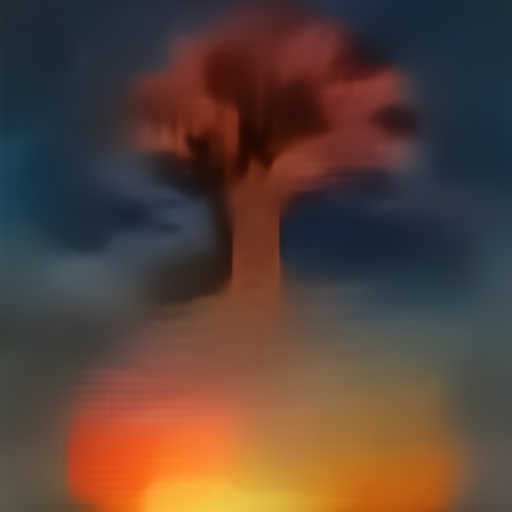




  ##########################################################
   [0, tensor([-3.7109], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 100


Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


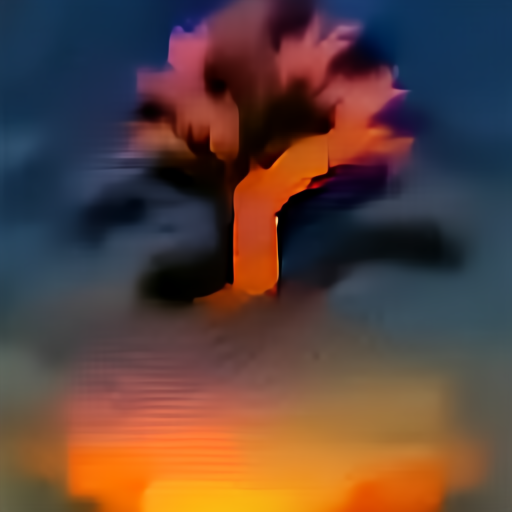




  ##########################################################
   [0, tensor([-4.0938], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 150


Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


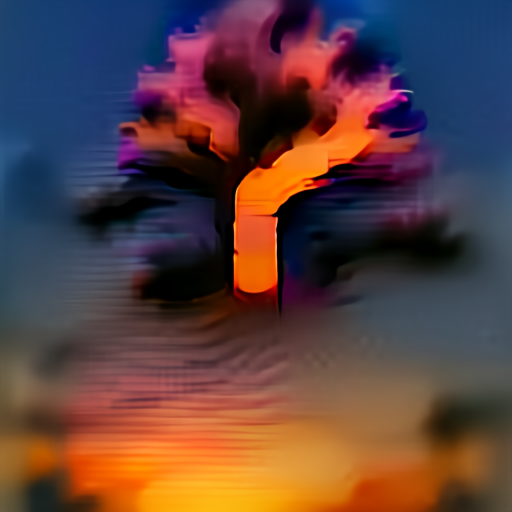




  ##########################################################
   [0, tensor([-4.0547], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 200


Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


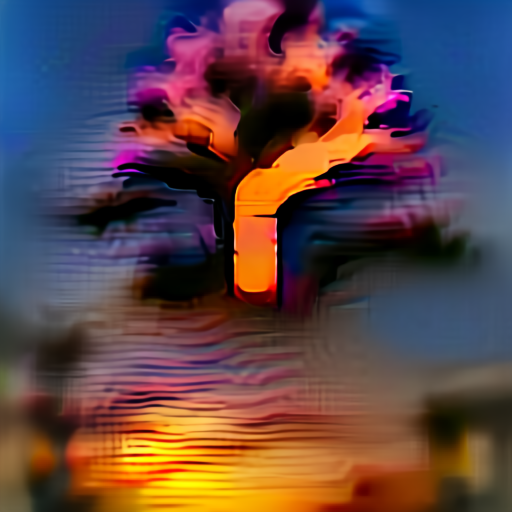




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-4.4102], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 250


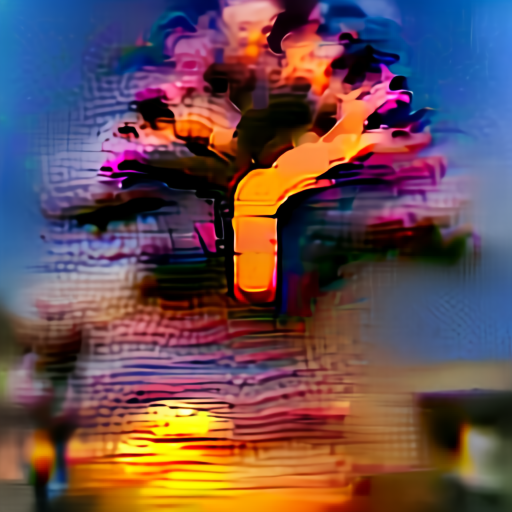




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-4.2383], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 300


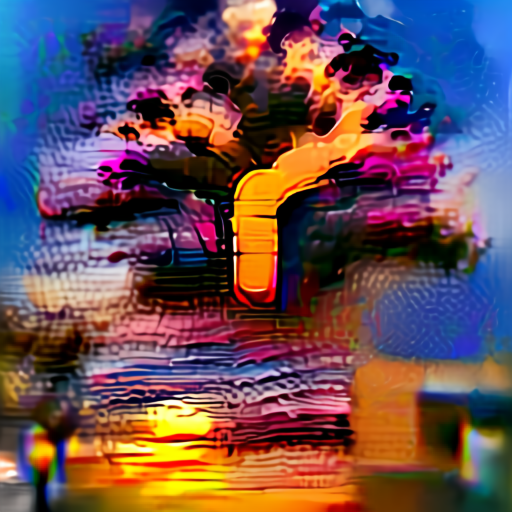




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-4.9141], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 350


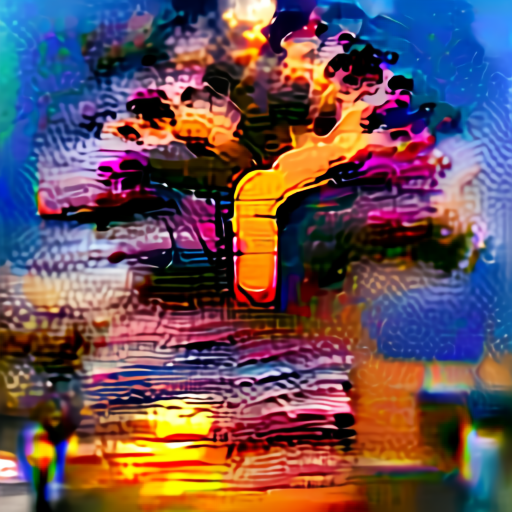




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-4.9375], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 400


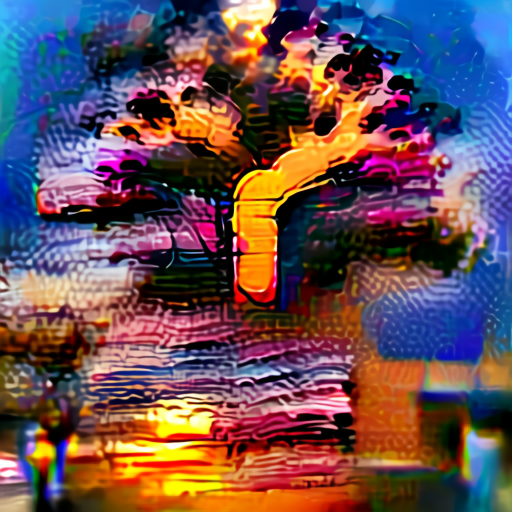




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-4.9375], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 450


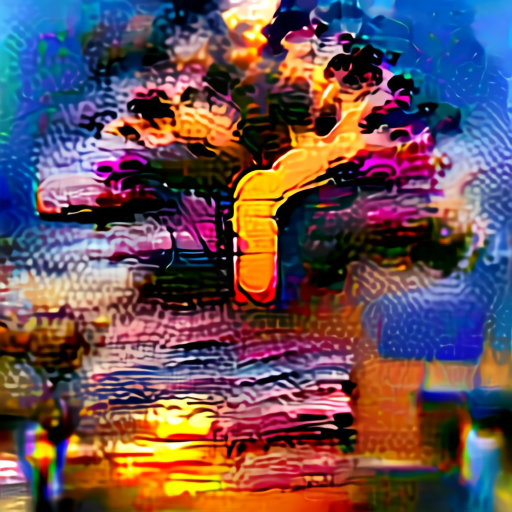




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-4.5781], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 500


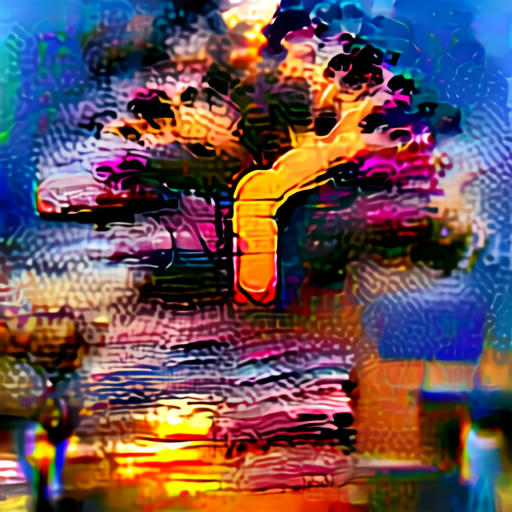




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-5.0352], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 550


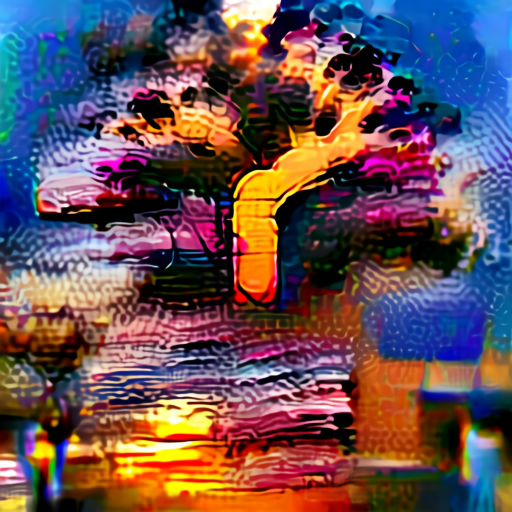




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-4.6367], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 600


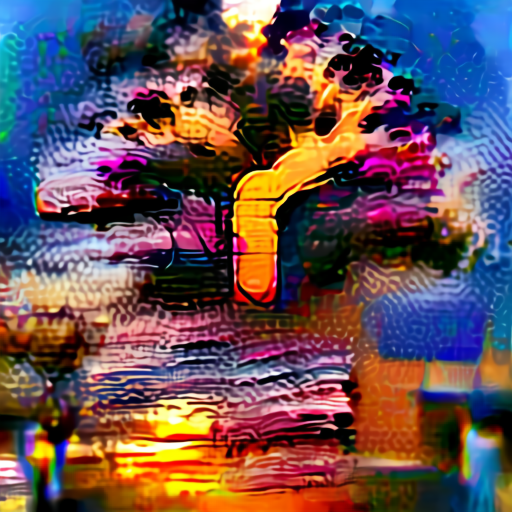




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-4.9492], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 650


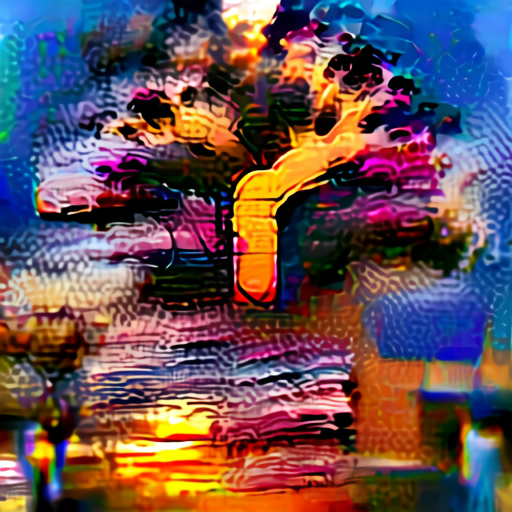




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-4.4766], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 700


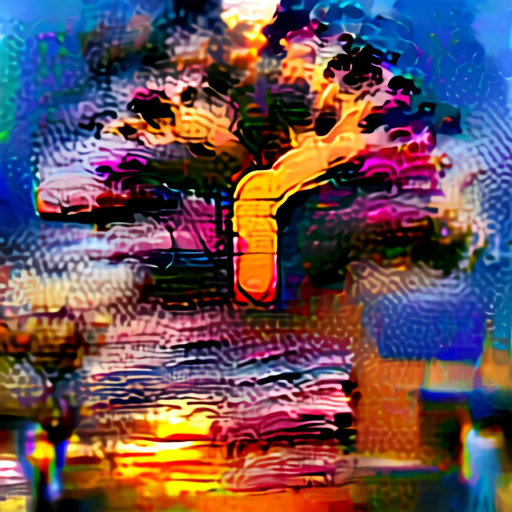




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-4.9609], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 750


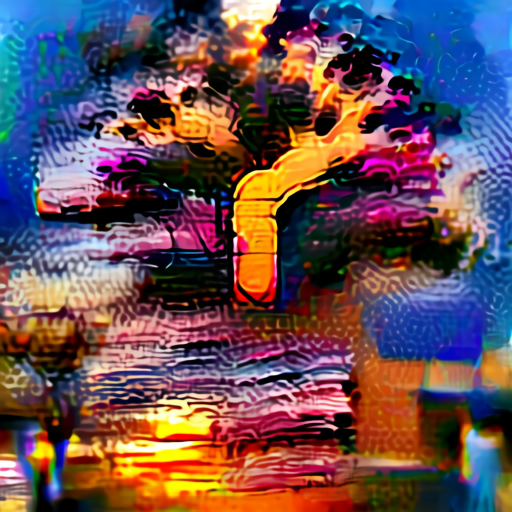




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-4.9453], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 800


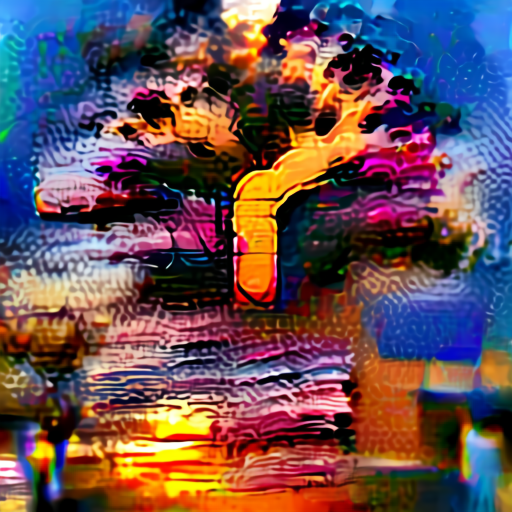




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-4.5703], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 850


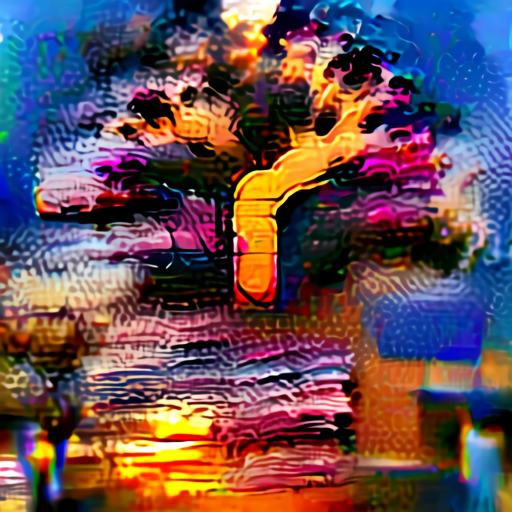




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-4.7812], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 900


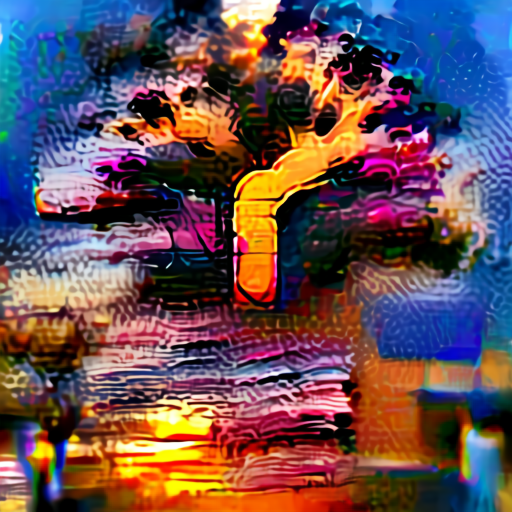




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-4.7227], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 950


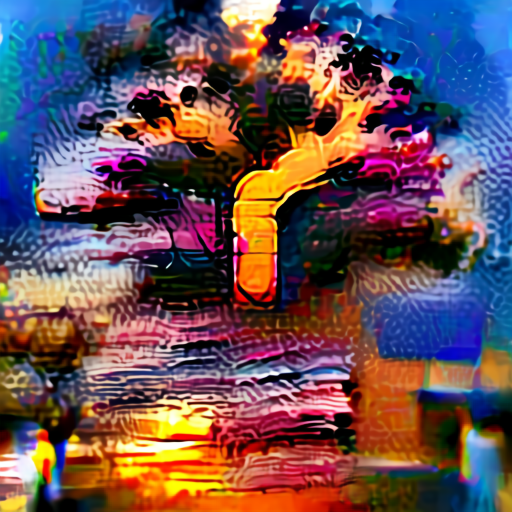




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-4.3555], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 1000


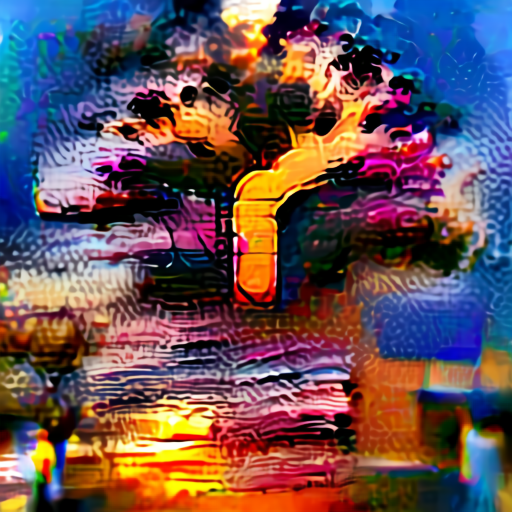




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-4.7305], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 1050


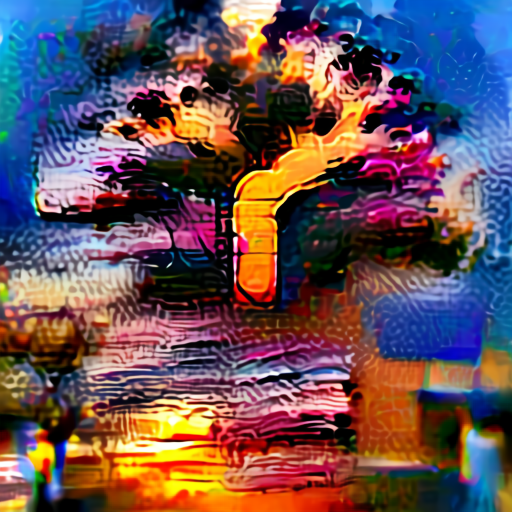




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-4.3594], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 1100


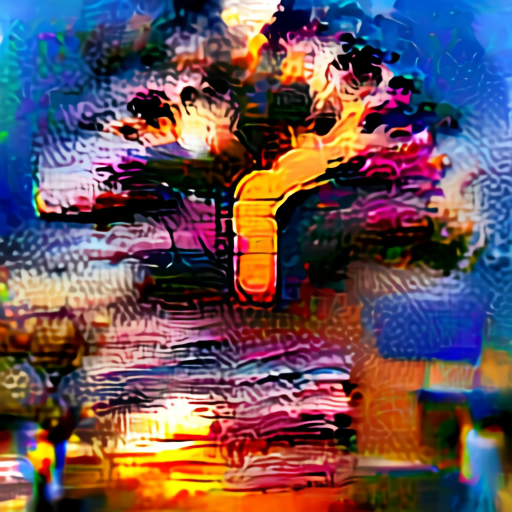




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-4.6602], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 1150


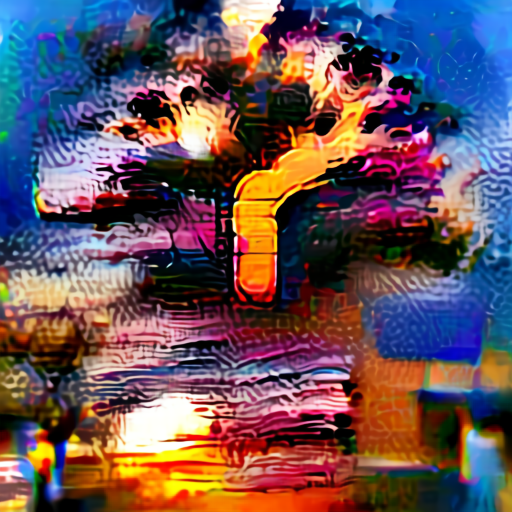




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-4.5156], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 1200


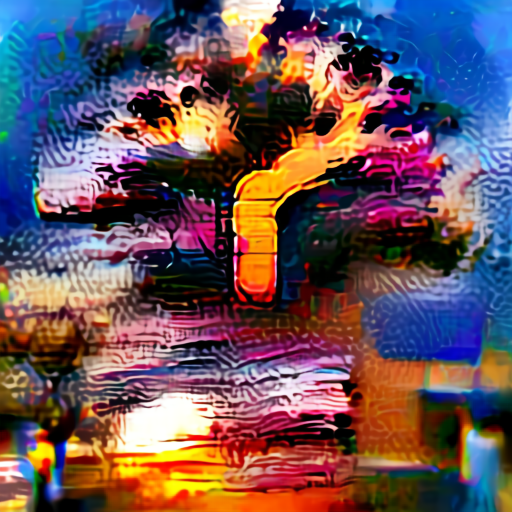




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-4.2656], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 1250


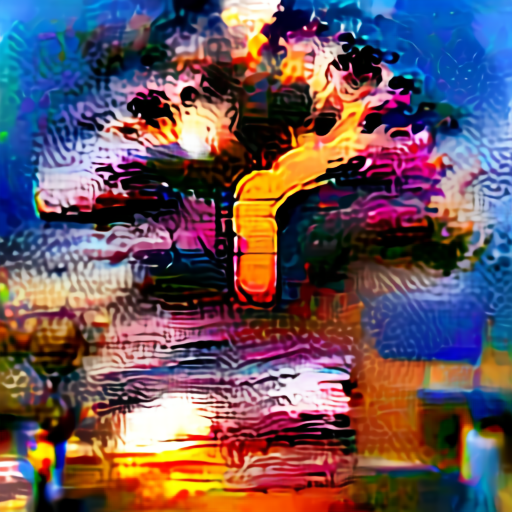




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-4.3984], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 1300


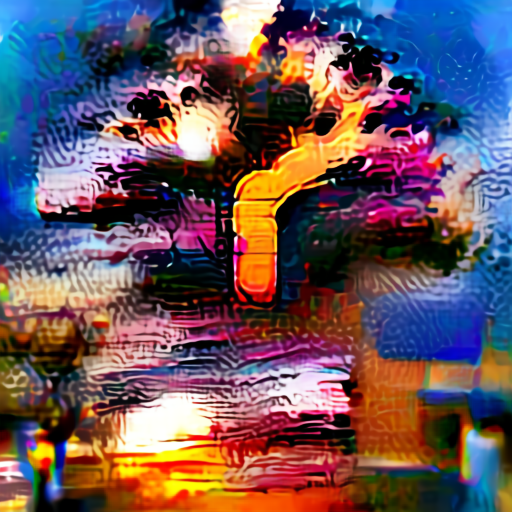




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-4.4180], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 1350


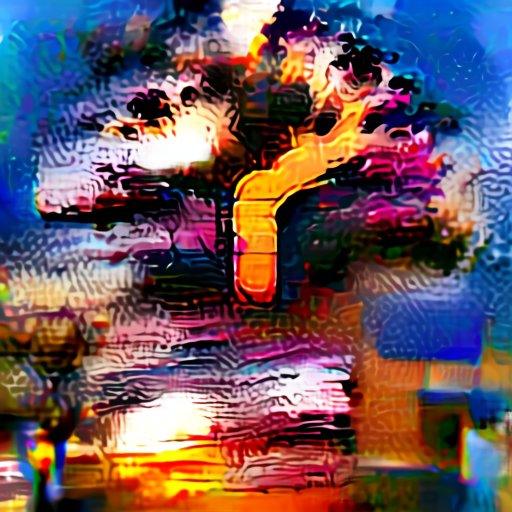




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-3.8652], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 1400


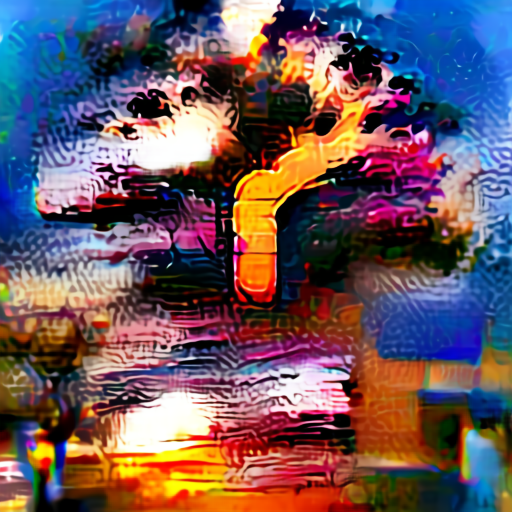




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-4.1875], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 1450


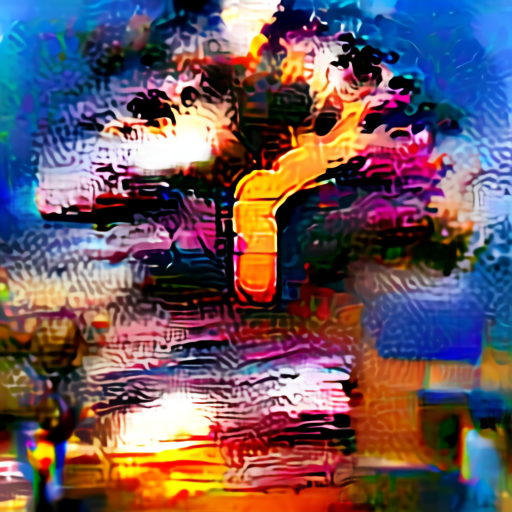




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-3.7188], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 1500


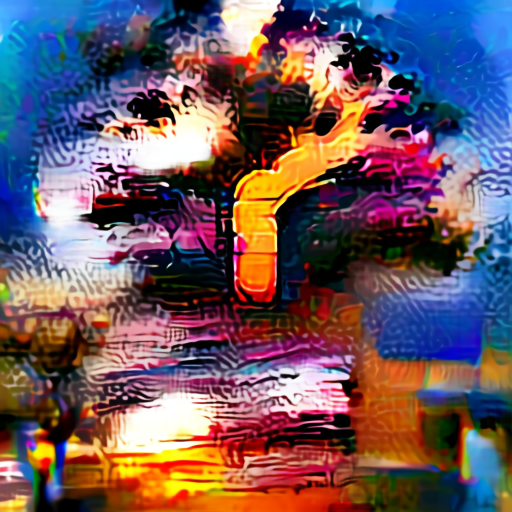




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-4.3320], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 1550


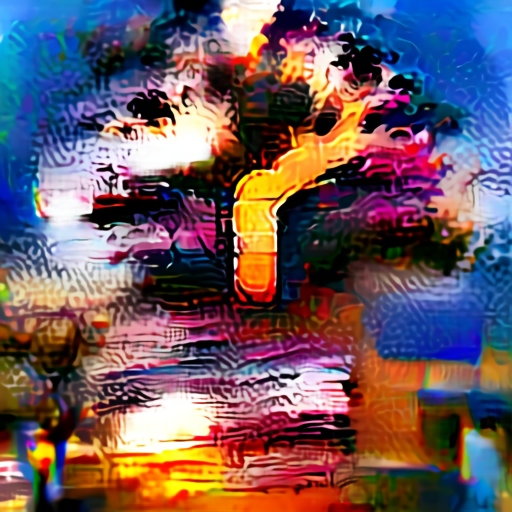




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-4.2344], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 1600


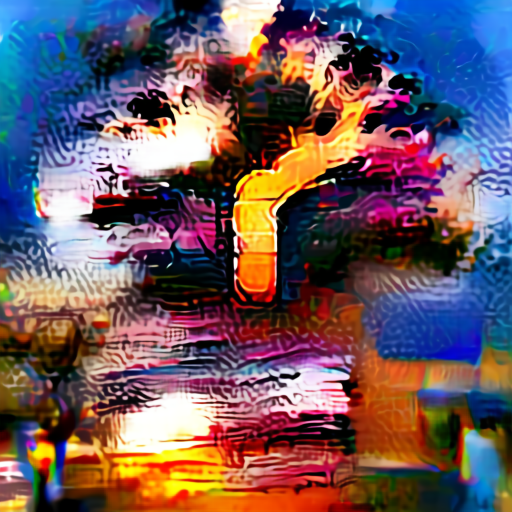




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-3.9219], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 1650


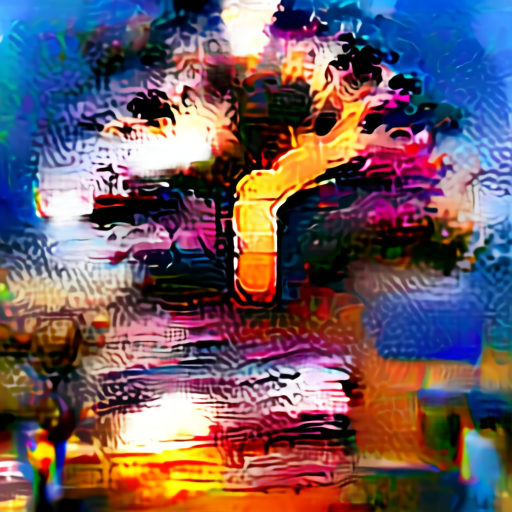




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-3.9414], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 1700


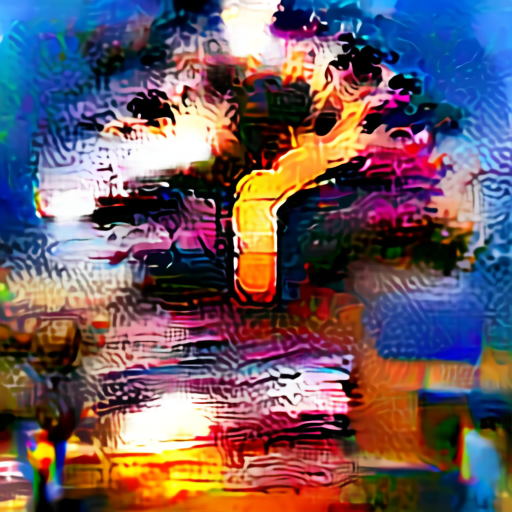




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-4.0664], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 1750


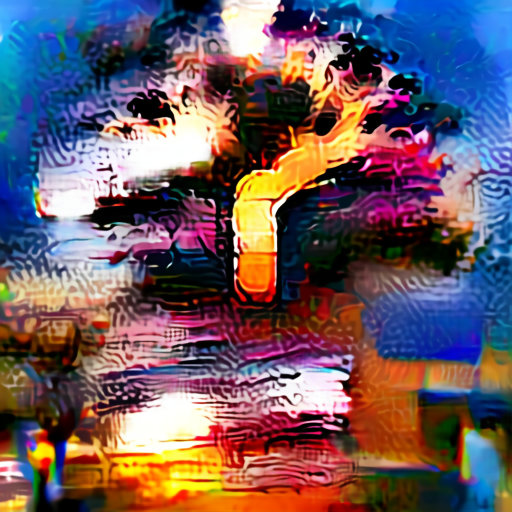




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-4.1055], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 1800


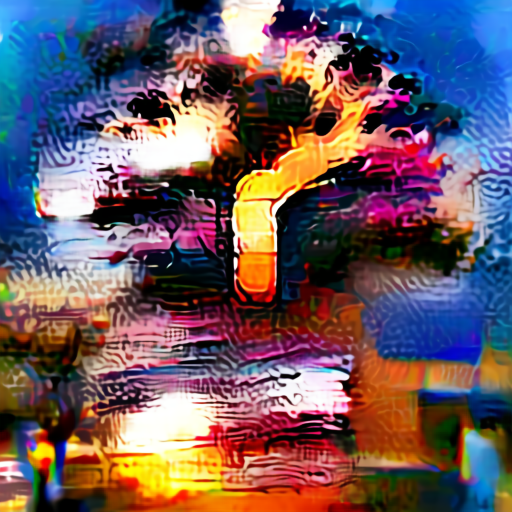




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-4.0273], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 1850


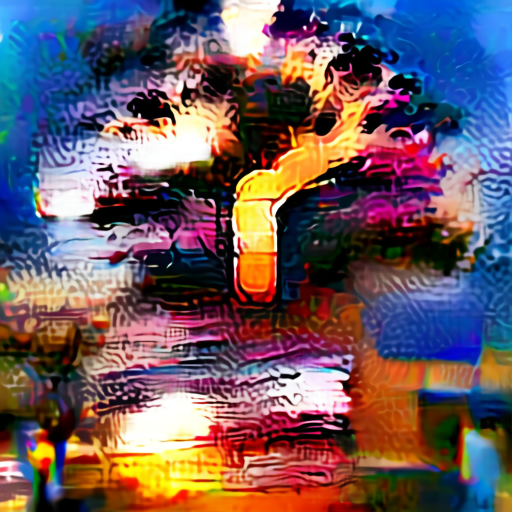




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-4.1562], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 1900


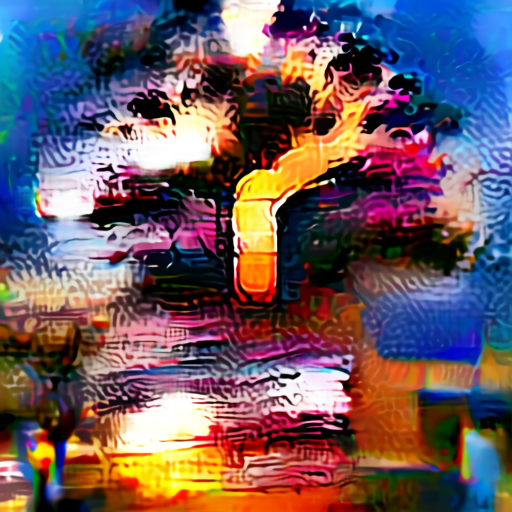




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-4.0078], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 1950


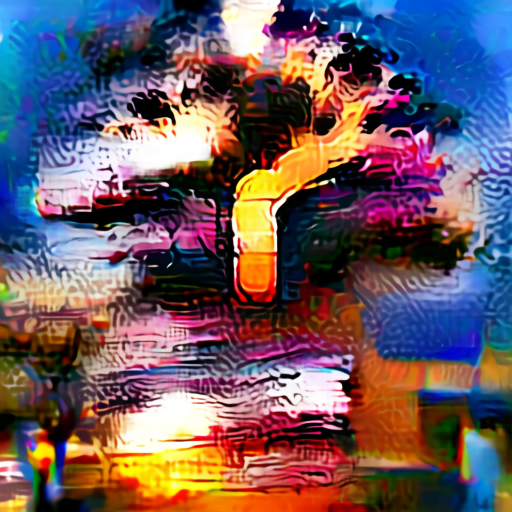




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-4.0391], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 2000


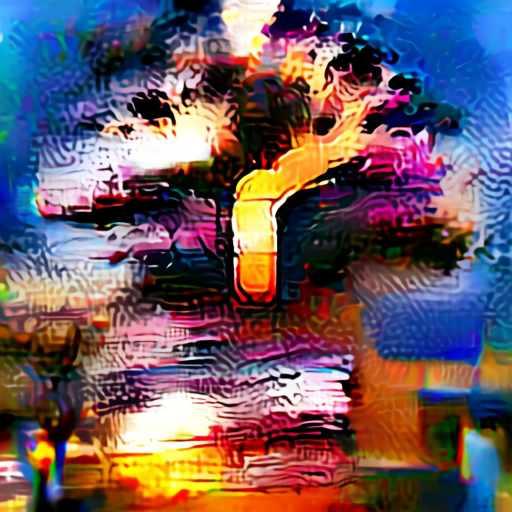




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-4.0703], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 2050


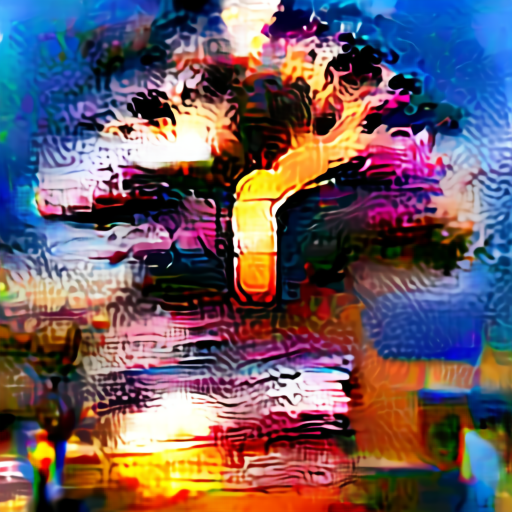




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-3.7090], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 2100


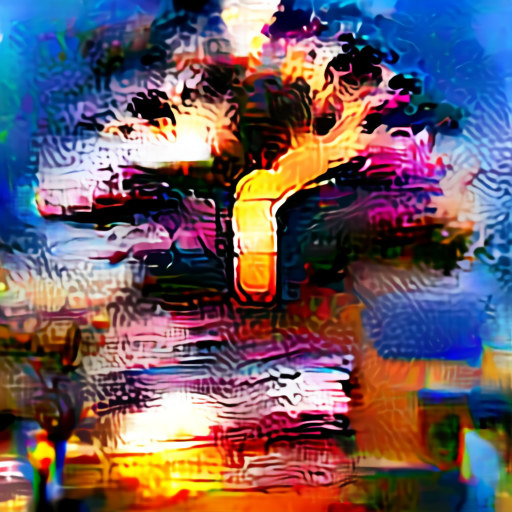




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-3.8262], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 2150


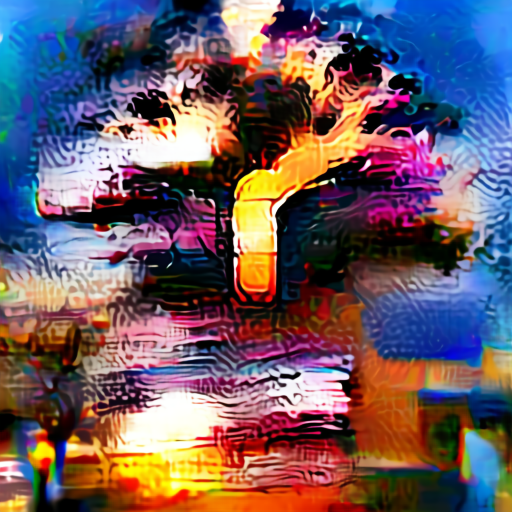




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-3.7109], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 2200


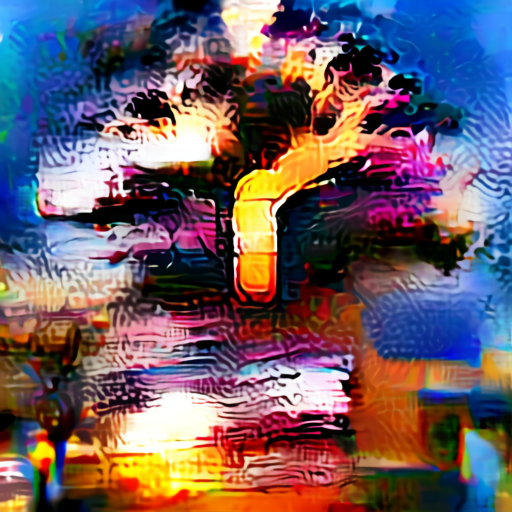




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-3.9062], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 2250


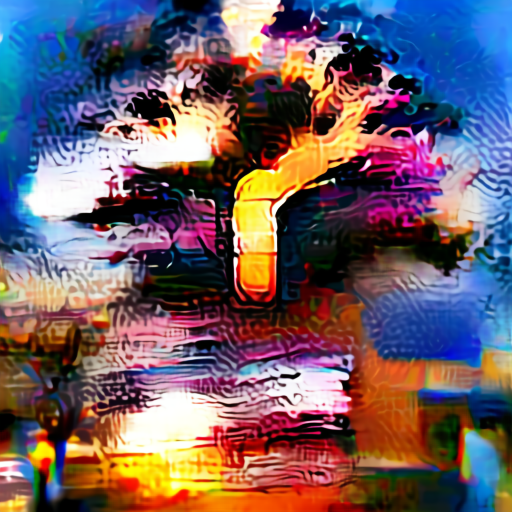




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-3.9043], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 2300


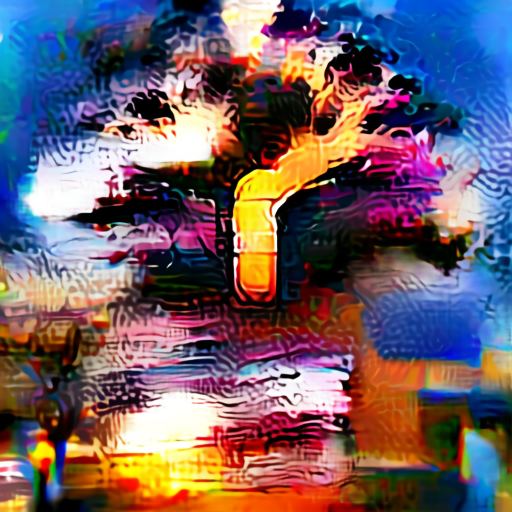




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-3.6699], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 2350


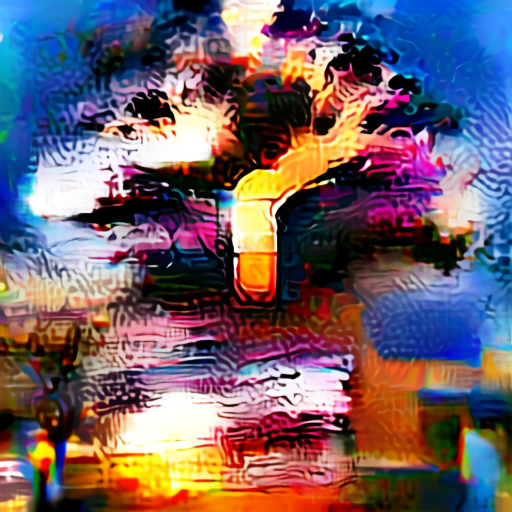




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-3.7852], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 2400


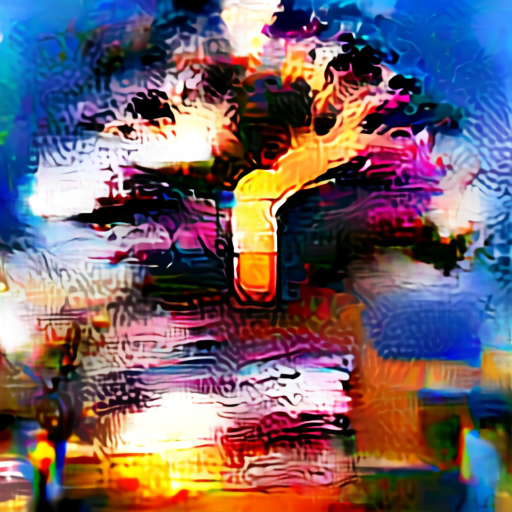




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-3.8379], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 2450


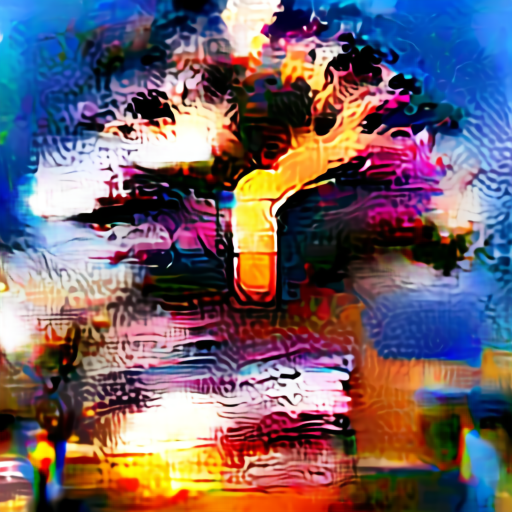




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-3.6348], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 2500


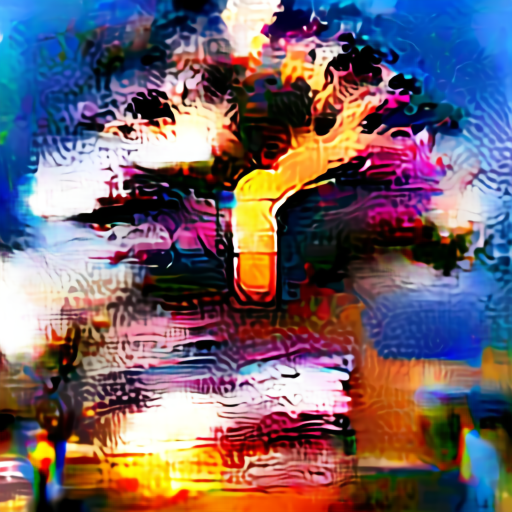




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-3.6211], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 2550


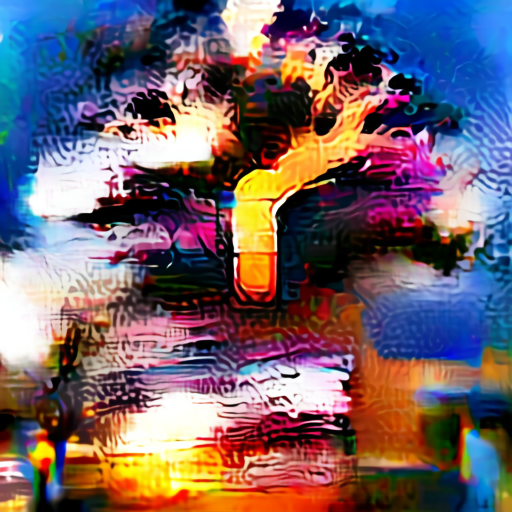




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-3.7910], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 2600


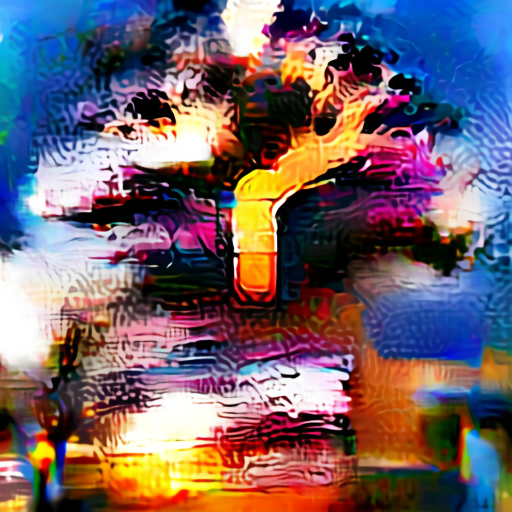




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-3.9297], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 2650


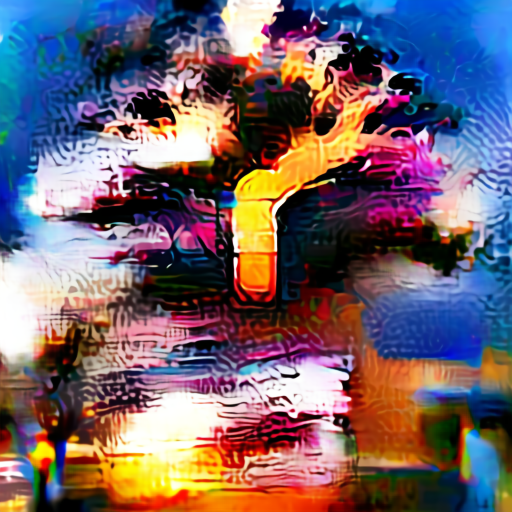




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-3.8242], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 2700


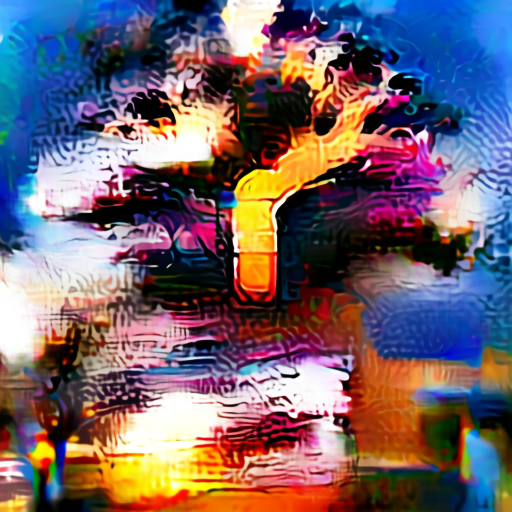




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-3.4570], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 2750


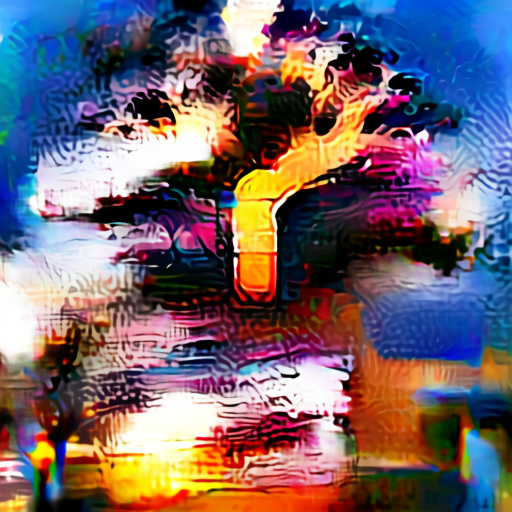




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-3.8320], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 2800


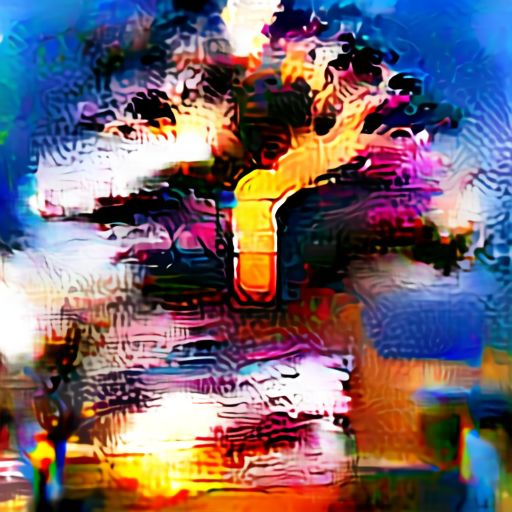




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-3.7656], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 2850


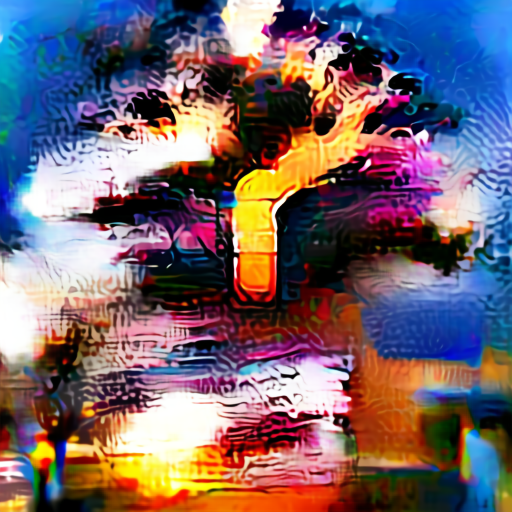




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-3.6523], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 2900


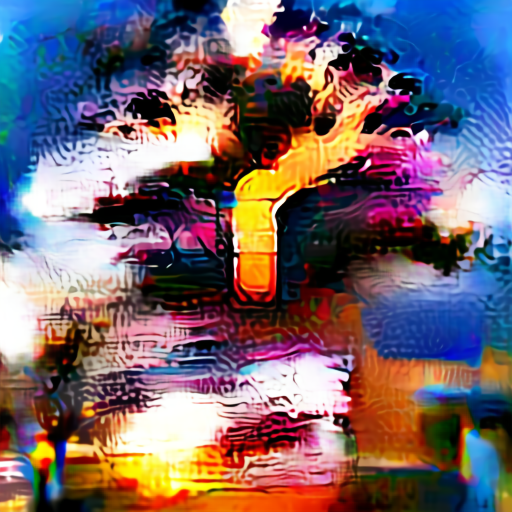




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-3.6680], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 2950


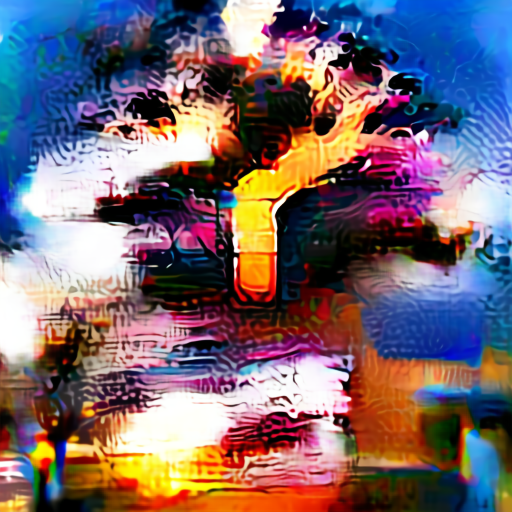




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-3.5547], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 3000


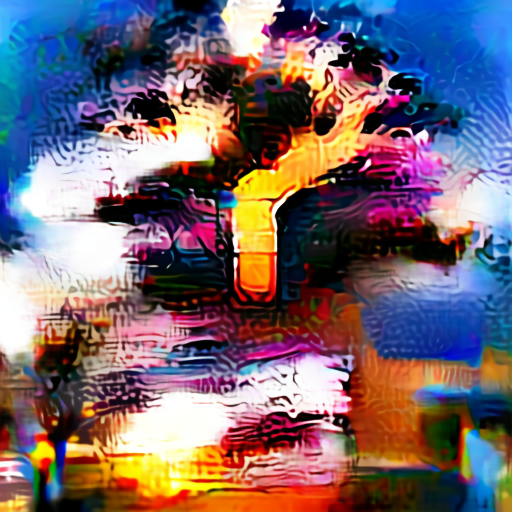




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-3.6484], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 3050


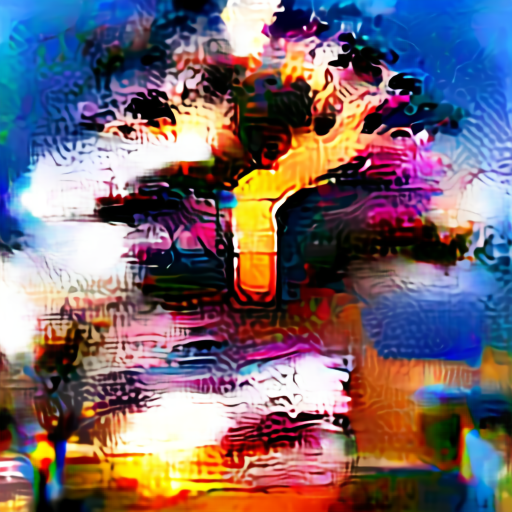




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-3.6133], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 3100


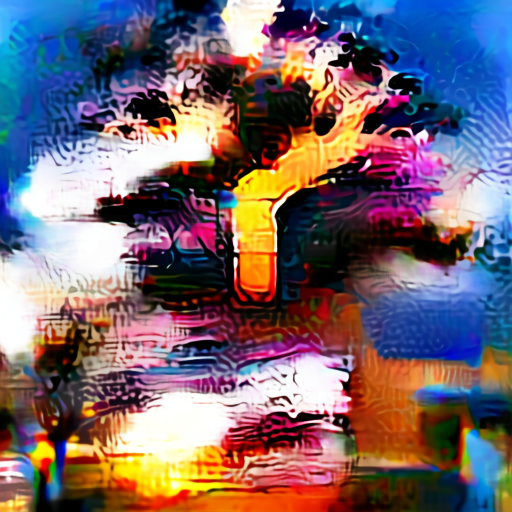




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-3.5742], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 3150


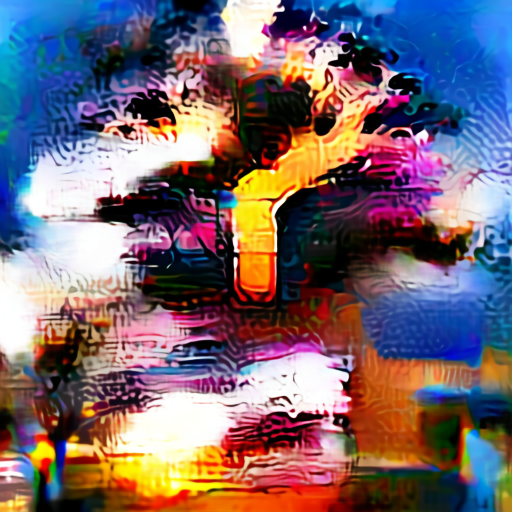




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-3.5391], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 3200


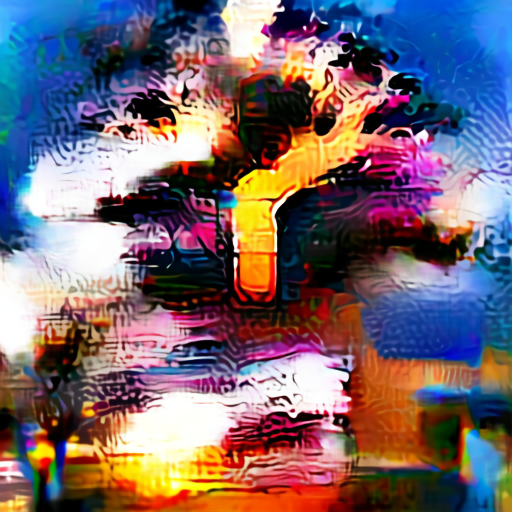




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-3.3633], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 3250


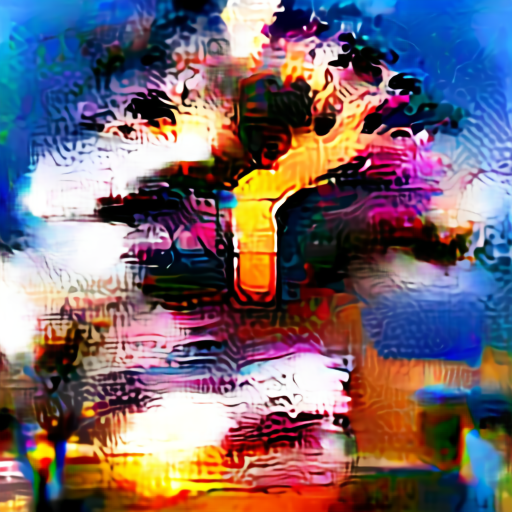




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-3.5898], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 3300


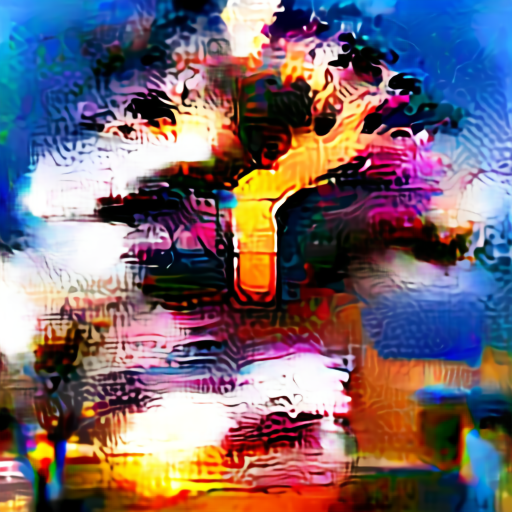




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-3.5723], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 3350


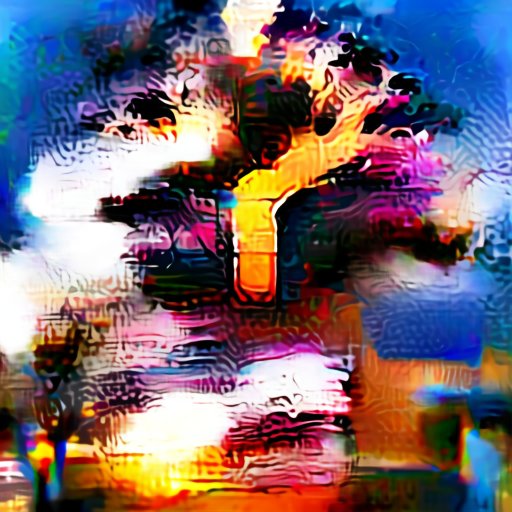




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-3.3789], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 3400


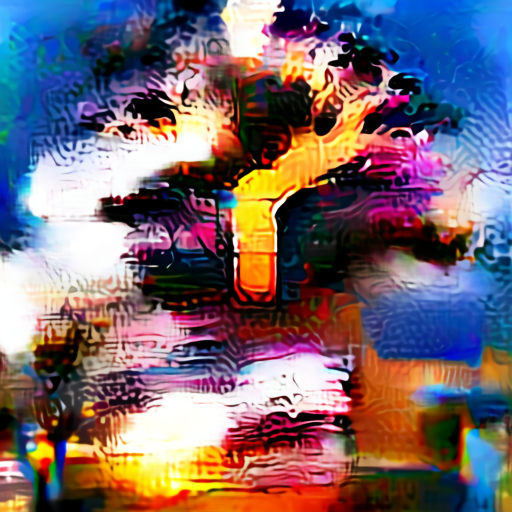




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-3.4336], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 3450


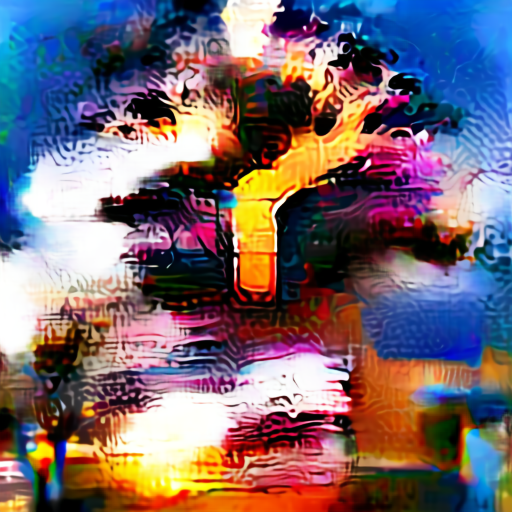




  ##########################################################
   

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


[0, tensor([-3.3125], device='cuda:0', dtype=torch.float16, grad_fn=<MulBackward0>)]  (loss)
 3500


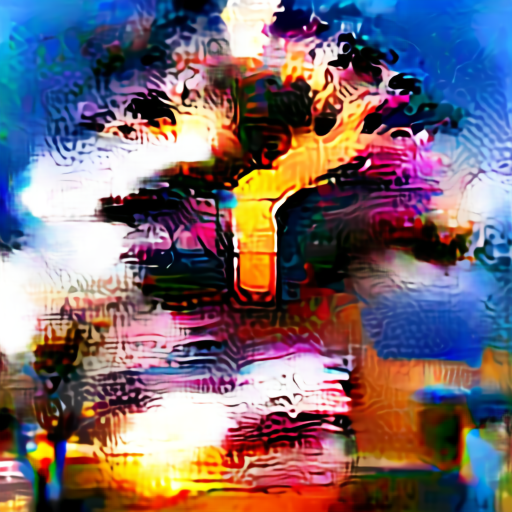

In [ ]:

def checkin(loss):
  global hadies
  print('''
  ##########################################################
  ''',
        loss, ' (loss)\n',itt)
  
  with torch.no_grad():
    
    al = unmap_pixels(torch.sigmoid(model(lats())[:, :3]).cpu().float()).numpy()
    for allls in al:
      displ(allls)
      display.display(display.Image(str(3)+'.png'))
      print('\n')



  # the people spoke and they love "ding"
  #eval_js('new Audio("https://freesound.org/data/previews/80/80921_1022651-lq.ogg").play()')


def ascend_txt():
  out = unmap_pixels(torch.sigmoid(model(lats())[:, :3].float()))

  

  cutn = 64 # improves quality
  p_s = []
  for ch in range(cutn):
    size = int(sideX*torch.zeros(1,).uniform_(.8, .99))#.normal_(mean=.8, std=.3).clip(.5, .98))
    offsetx = torch.randint(0, sideX - size, ())
    offsety = torch.randint(0, sideX - size, ())
    apper = out[:, :, offsetx:offsetx + size, offsety:offsety + size]
    apper = torch.nn.functional.interpolate(apper, (224,224), mode='bilinear')
    p_s.append(apper)
  into = torch.cat(p_s, 0)
  # into = torch.nn.functional.interpolate(out, (224,224), mode='bilinear')

  into = into + .2 * random.random() * torch.randn_like(into)

  into = nom((into))


  iii = perceptor.encode_image(into)


  lat_l = 0



  return [lat_l, 10*-torch.cosine_similarity(t, iii).view(-1, batch_size).T.mean(1)]

def train(i):
  global hadies
  loss1 = ascend_txt()
  loss = loss1[0] + loss1[1]
  loss = loss.mean()
  optimizer.zero_grad()
  loss.backward()
  optimizer.step()
  
  # hadies /= 1.01
  # hadies = max(hadies, 1.5)

  for g in optimizer.param_groups:
    g['lr'] = g['lr']*1.005
    
  
  if itt % 50 == 0:
    # print('temp', hadies)
    # print(g['lr'], 'lr')
    checkin(loss1)


itt = 0
for asatreat in range(10000):
  train(itt)
  itt+=1



# Sharpie

In [ ]:
hadies = 130000000
will_it = True

with torch.no_grad():
  lll = lats()
  al = unmap_pixels(torch.sigmoid(model(lll)[:, :3]).cpu().float()).numpy()
  for allls in al:
    displ(allls)
    print('\n')

  # print(lll)
  # print(torch.sum(lll))
  displ(torch.topk(lll.view(batch_size, 8192, 64, 64), k=3, dim=1)[0].cpu().numpy()[0])

In [ ]:
print(lats())